# Driving data

Visualize the driving data with the used sensors (i.e,. 3 RGB/depth/semantic segmentation cameras).

In [2]:
from glob import glob
import os
import numpy as np
import pandas as pd
from multiprocessing import Pool
from tqdm import tqdm

In [3]:
# Get all the paths for all the data in the dataset
def get_paths(data_root: str, sensors: list = ['can_bus', 'depth', 'rgb', 'ss']) -> list:
    # Let's get all the paths for ALL the files in the dataset
    paths = glob(os.path.join(data_root, '*'), recursive=True)
    # Filter out with the sensors + only files
    paths = [path for path in paths if (any(sensor in path for sensor in sensors) and os.path.isfile(path))]
    # Sort the paths
    return sorted(paths)


In [4]:
data_root = os.path.join('/run/user/1001/gvfs/sftp:host=158.109.8.151,port=22345', 
                         'datafast/Datasets/dporres/CARLA/training_Town01_dense_clearnoon/ClearNoon_route00001')

p = get_paths(data_root=data_root, sensors=['can_bus', 'depth', 'rgb', 'ss'])

In [5]:
# Now, let's show the sensor data side-by-side; first just the 3 RGB cameras (rgb_left, rgb_center, rgb_right)

# Let's get the paths for the 3 RGB cameras
rgb_paths = [path for path in p if 'rgb' in path]
depth_paths = [path for path in p if 'depth' in path]
ss_paths = [path for path in p if 'ss' in path]
can_bus_paths = [path for path in p if 'can_bus' in path]

assert len(rgb_paths) == len(depth_paths) == len(ss_paths) == len(can_bus_paths) * 3

num_data = len(can_bus_paths)

In [6]:
rgb_paths[0], rgb_paths[num_data], rgb_paths[2*num_data]

('/run/user/1001/gvfs/sftp:host=158.109.8.151,port=22345/datafast/Datasets/dporres/CARLA/training_Town01_dense_clearnoon/ClearNoon_route00001/rgb_central000000.png',
 '/run/user/1001/gvfs/sftp:host=158.109.8.151,port=22345/datafast/Datasets/dporres/CARLA/training_Town01_dense_clearnoon/ClearNoon_route00001/rgb_left000000.png',
 '/run/user/1001/gvfs/sftp:host=158.109.8.151,port=22345/datafast/Datasets/dporres/CARLA/training_Town01_dense_clearnoon/ClearNoon_route00001/rgb_right000000.png')

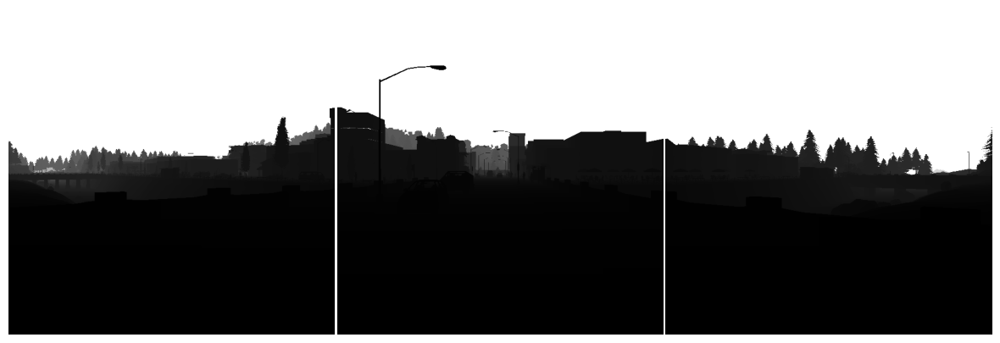

In [7]:
import cv2
import matplotlib.pyplot as plt

depth_central = cv2.cvtColor(cv2.imread(depth_paths[0], cv2.IMREAD_UNCHANGED), cv2.COLOR_BGR2RGB)
depth_left = cv2.cvtColor(cv2.imread(depth_paths[num_data], cv2.IMREAD_UNCHANGED), cv2.COLOR_BGR2RGB)
depth_right = cv2.cvtColor(cv2.imread(depth_paths[2*num_data], cv2.IMREAD_UNCHANGED), cv2.COLOR_BGR2RGB)

def process_depth_image(depth_img):
    depth_not_norm = np.add(depth_img[:,:,0], np.add(np.multiply(depth_img[:,:,1], 256), np.multiply(depth_img[:,:,2], 256**2)))
    processed_depth = np.multiply(np.divide(depth_not_norm, 256**3-1),1000)
    return processed_depth

depth_central = process_depth_image(depth_central)
depth_left = process_depth_image(depth_left)
depth_right = process_depth_image(depth_right)

fig, ax = plt.subplots(1,3, figsize=(15,5))
ax[0].imshow(depth_left, cmap='gray')
ax[1].imshow(depth_central, cmap='gray')
ax[2].imshow(depth_right, cmap='gray')
# Remove spacing and margins, as well as ticks
for axi in ax:
    axi.set_xticks([])
    axi.set_yticks([])
    axi.axis('off')
# Remove the space between the subplots
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

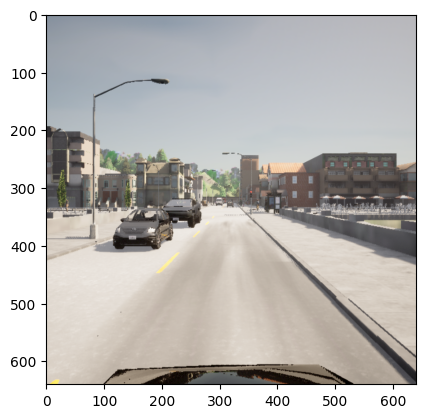

In [8]:
import matplotlib.pyplot as plt

rgb = plt.imread(rgb_paths[0])
plt.imshow(rgb)
plt.show()

In [55]:
import cv2
import numpy as np
import os

CONVERTER = np.uint8([
    0,    # unlabeled
    0,    # building
    0,    # fence
    0,    # other
    1,    # ped
    0,    # pole
    1,    # road line
    0,    # road
    0,    # sidewalk
    0,    # vegetation
    1,    # car
    0,    # wall
    0,    # traffic sign
    0,    # sky
    0,    # ground
    0,    # bridge
    0,    # railtrack
    0,    # guardrail
    1,    # trafficlight
    0,    # static
    0,    # dynamic
    0,    # water
    0,    # terrain
    ])

classes = {
        0: [0, 0, 0],  # None
        1: [70, 70, 70],  # Buildings
        2: [100, 40, 40],  # Fences
        3: [55, 90, 80],  # Other
        4: [220, 20, 60],  # Pedestrians
        5: [153, 153, 153],  # Poles
        6: [157, 234, 50],  # RoadLines
        7: [128, 64, 128],  # Roads
        8: [244, 35, 232],  # Sidewalks
        9: [107, 142, 35],  # Vegetation
        10: [0, 0, 142],  # Vehicles
        11: [102, 102, 156],  # Walls
        12: [220, 220, 0],  # TrafficSigns
        13: [70, 130, 180],  # Sky
        14: [81, 0, 81],  # Ground
        15: [150, 100, 100],  # Bridges
        16: [230, 150, 140],  # RailTracks
        17: [180, 165, 180],  # GuardRails
        18: [250, 170, 30],  # TrafficLights
        19: [110, 190, 160],  # Statics
        20: [170, 120, 50],  # Dynamics
        21: [45, 60, 150],  # Water
        22: [145, 170, 100]  # Terrains
}


def read_images(src_path, depth_path, segmented_path):
    src_img = cv2.imread(src_path)
    src_img = cv2.cvtColor(src_img, cv2.COLOR_BGR2RGB)
    depth_img = cv2.imread(depth_path, cv2.IMREAD_UNCHANGED)
    depth_img = cv2.cvtColor(depth_img, cv2.COLOR_BGR2RGB)
    segmented_img = cv2.imread(segmented_path, cv2.IMREAD_UNCHANGED)

    if segmented_img.ndim == 3 and segmented_img.shape[2] == 4:  # Check if it's an RGB image
        segmented_img = segmented_img[:, :, -2:-5:-1]
        segmented_one_channel = np.zeros((segmented_img.shape[0], segmented_img.shape[1]), dtype=np.uint8)
        for label, color in classes.items():
            mask = np.all(segmented_img == np.array(color).reshape(1, 1, 3), axis=2)
            segmented_one_channel[mask] = label
        segmented_img = segmented_one_channel
    return src_img, depth_img, segmented_img

def process_depth_image(depth_img):
    depth_not_norm = np.add(depth_img[:,:,0], np.add(np.multiply(depth_img[:,:,1], 256), np.multiply(depth_img[:,:,2], 256**2)))
    processed_depth = np.multiply(np.divide(depth_not_norm, 256**3-1),1000)
    return processed_depth

def create_masks(depth_img, segmentation, converter, road_label: int = 7, sidewalk_label: int = 8,  
                 central_camera: bool = False, depth_threshold: float = 20.0, min_depth: float = 2.3,
                 dilation_kernel_size: int = 10, dilation_iterations: int = 1):
    min_depth = min_depth if central_camera else 0
    depth_condition = (depth_img < depth_threshold) & (depth_img > min_depth)
    mask_depth = np.where(depth_condition, 255, 0).astype(np.uint8)
    mask_segmentation = np.isin(segmentation, np.where(converter==1)[0]).astype(np.uint8) * 255
    road_mask = (segmentation == road_label).astype(np.uint8)
    sidewalk_mask = (segmentation == sidewalk_label).astype(np.uint8)
    return mask_depth, mask_segmentation, road_mask, sidewalk_mask

def find_boundary(road_mask, sidewalk_mask, dilation_kernel_size: int = 10, dilation_iterations: int = 1):
    dilated_road = cv2.dilate(road_mask, np.ones((dilation_kernel_size, dilation_kernel_size), np.uint8), iterations=dilation_iterations)
    boundary = cv2.bitwise_and(dilated_road, sidewalk_mask)
    boundary = (boundary > 0).astype(np.uint8) * 255
    return boundary

def get_features(src_path, depth_path, segmented_path, central_camera: bool = True):
    src_img, depth_rgb, segmentation = read_images(src_path, depth_path, segmented_path)
    depth_img = process_depth_image(depth_rgb)
    mask_depth, mask_segmentation, road_mask, sidewalk_mask = create_masks(depth_img, segmentation, CONVERTER, central_camera=central_camera)
    boundary = find_boundary(road_mask, sidewalk_mask)
    merge_boundary = cv2.bitwise_or(boundary, mask_segmentation)
    merge = cv2.bitwise_and(mask_depth, merge_boundary)
    return src_img, depth_img, segmentation, mask_depth, mask_segmentation, boundary, merge, merge_boundary

def show_images(src_img, depth_img, mask_depth, mask_segmentation, boundary, merge, merge_boundary):
    cv2.imshow("Source Image", src_img)
    cv2.imshow("Depth Image", depth_img)
    cv2.imshow("Mask Depth", mask_depth)
    cv2.imshow("Mask Segmentation", mask_segmentation)
    cv2.imshow("Boundary Road", boundary)
    cv2.imshow("Merge", merge)
    cv2.imshow("Merge Boundary", merge_boundary)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

def save_images(src_img, depth_img, mask_depth, mask_segmentation, boundary, merge, merge_boundary, path="reprojected_images/"):
    #if path does not exist create it
    if not os.path.exists(path):
        os.makedirs(path)
    cv2.imwrite(path + "src_img.png", src_img)
    cv2.imwrite(path + "depth_img.png", depth_img)
    cv2.imwrite(path + "mask_depth.png", mask_depth)
    cv2.imwrite(path + "mask_segmentation.png", mask_segmentation)
    cv2.imwrite(path + "boundary.png", boundary)
    cv2.imwrite(path + "merge.png", merge)
    cv2.imwrite(path + "merge_boundary.png", merge_boundary)

def main():
    src_path = '/home/tda/Data_test/routes_training_03_08_20_03_40/rgb_hr/0003.png'
    depth_path = '/home/tda/Data_test/routes_training_03_08_20_03_40/depth/0003.png'
    segmented_path = '/home/tda/Data_test/routes_training_03_08_20_03_40/segmented/0003.png'
    src_img, depth_img, mask_depth, mask_segmentation, boundary, merge, merge_boundary = get_features(src_path, depth_path, segmented_path)
    # show_images(src_img, depth_img, mask_depth, mask_segmentation, boundary, merge, merge_boundary)
    save_images(src_img, depth_img, mask_depth, mask_segmentation, boundary, merge, merge_boundary)

In [35]:
src_img, depth_img, segmentation, mask_depth, mask_segmentation, boundary, merge, merge_boundary = get_features(rgb_paths[100], depth_paths[100], ss_paths[100])

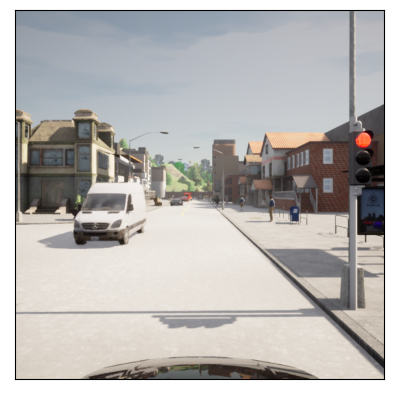

In [37]:
plt.imshow(src_img)
plt.xticks([])
plt.yticks([])
plt.show()

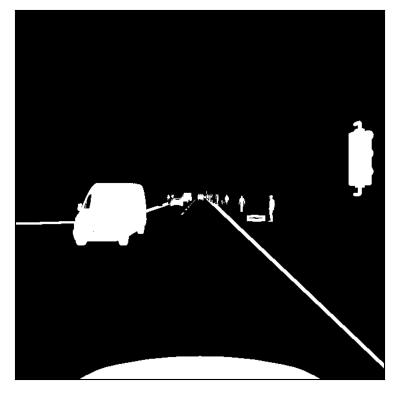

In [52]:
plt.imshow(merge_boundary, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

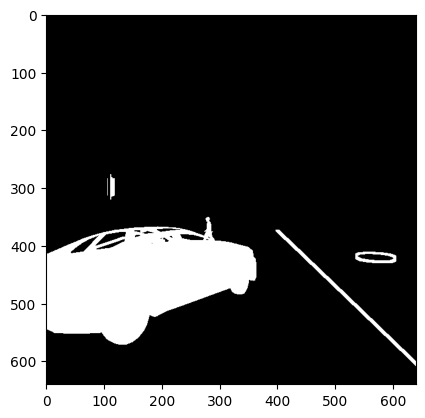

In [13]:
plt.imshow(merge, cmap='gray')

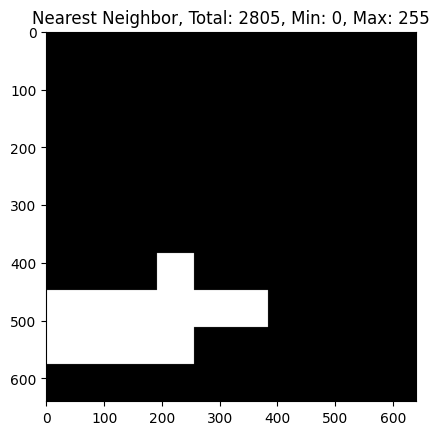

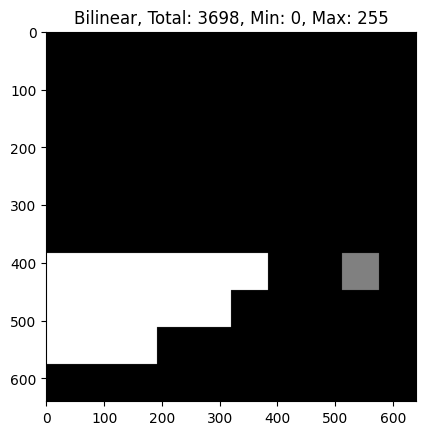

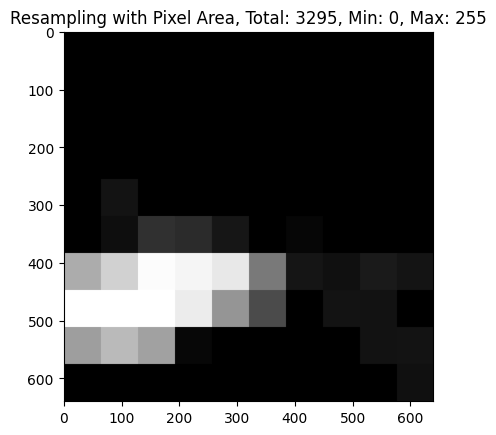

In [14]:
interpolations_dict = {
    'Nearest Neighbor': cv2.INTER_NEAREST, 
    'Bilinear': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'Resampling with Pixel Area': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}

for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)

    plt.imshow(merge_resized, cmap='gray')
    plt.title(f'{name}, Total: {tot}, Min: {merge_resized.min()}, Max: {merge_resized.max()}')
    plt.show()


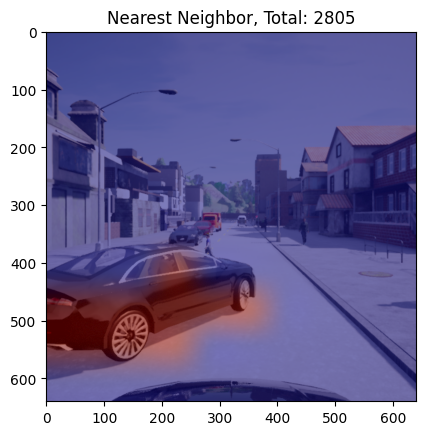

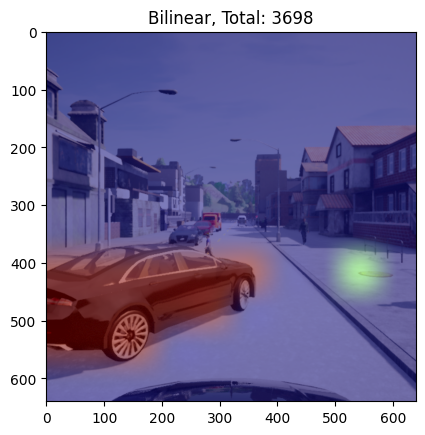

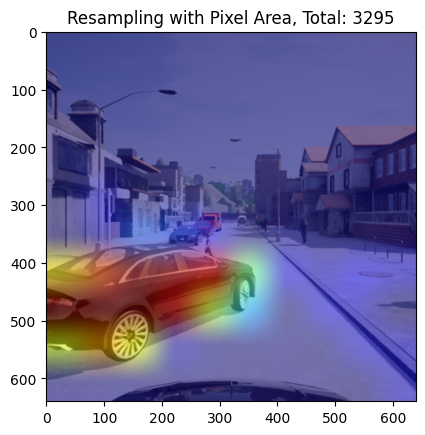

In [15]:
from PIL import Image

# Let's add the merge_resized to the original image as a heatmap and plot them
for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    # merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)
    merge_resized = np.delete(plt.get_cmap('jet')(merge_resized), 3, 2)
    merge_resized = Image.fromarray((255 * merge_resized).astype(np.uint8)).resize(src_img.shape[:2])
    # Add the heatmap to the original image as a mask
    src_img_copy = Image.fromarray(src_img.copy())

    # Blend them
    blend = Image.blend(src_img_copy, merge_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.show()

In [16]:
src_img, depth_img, segmentation, mask_depth, mask_segmentation, boundary, merge, merge_boundary = get_features(rgb_paths[-1], depth_paths[-1], ss_paths[-1])

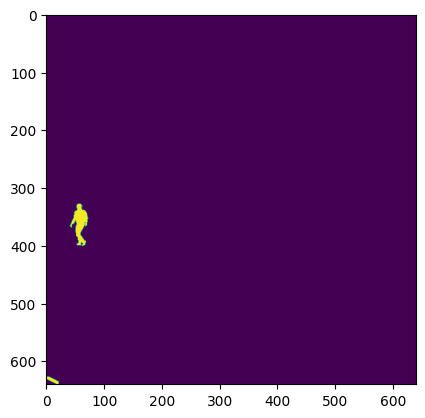

In [17]:
plt.imshow(merge)

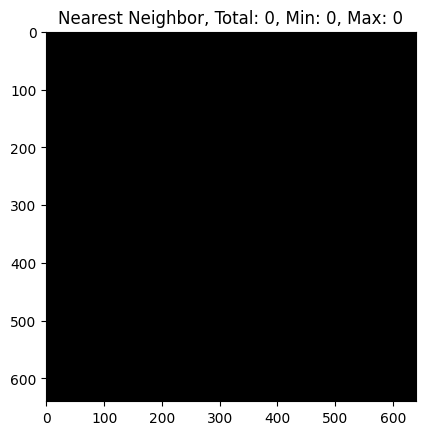

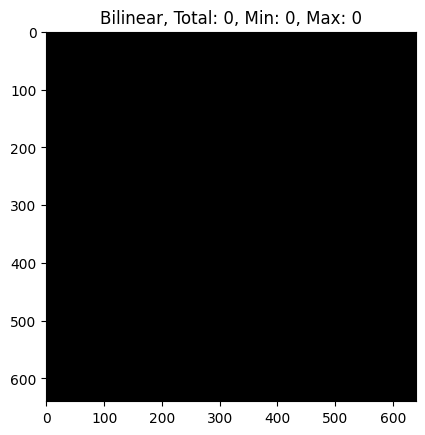

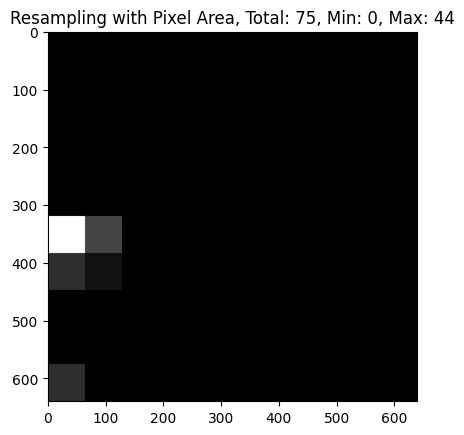

In [18]:

for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)

    plt.imshow(merge_resized, cmap='gray')
    plt.title(f'{name}, Total: {tot}, Min: {merge_resized.min()}, Max: {merge_resized.max()}')
    plt.show()

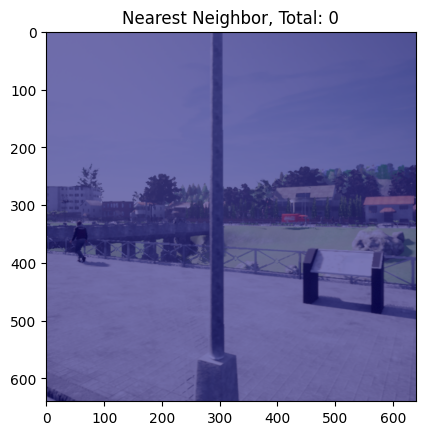

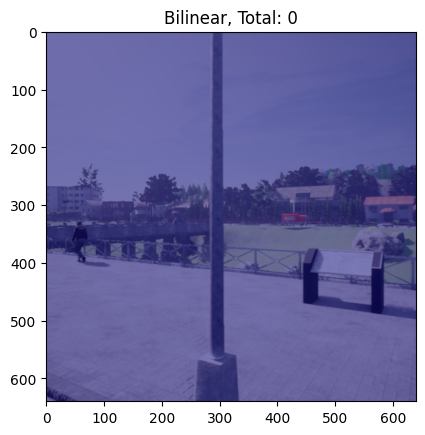

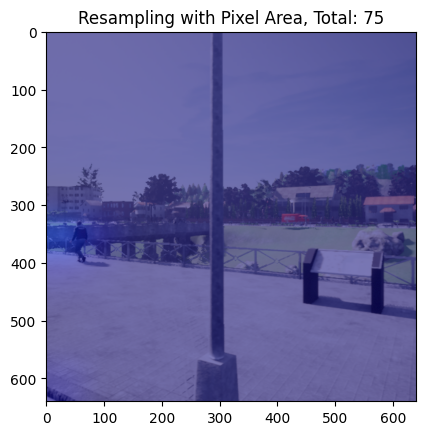

In [19]:
# Let's add the merge_resized to the original image as a heatmap and plot them
for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    # merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)
    merge_resized = np.delete(plt.get_cmap('jet')(merge_resized), 3, 2)
    merge_resized = Image.fromarray((255 * merge_resized).astype(np.uint8)).resize(src_img.shape[:2])
    # Add the heatmap to the original image as a mask
    src_img_copy = Image.fromarray(src_img.copy())

    # Blend them
    blend = Image.blend(src_img_copy, merge_resized, 0.5)

    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.show()

In [20]:
src_img, depth_img, segmentation, mask_depth, mask_segmentation, boundary, merge, merge_boundary = get_features(rgb_paths[num_data + 100], depth_paths[num_data + 100], ss_paths[num_data + 100])

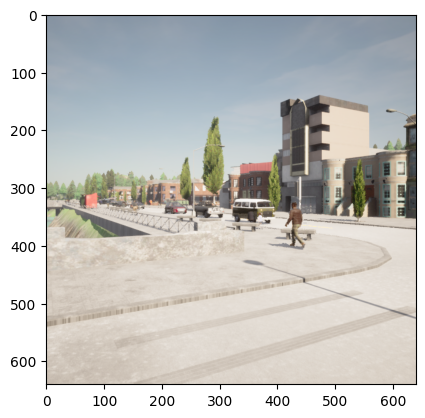

In [21]:
plt.imshow(src_img)

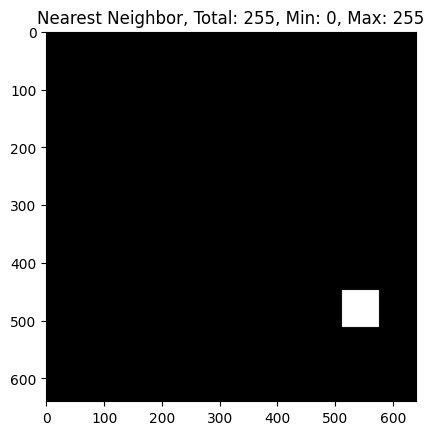

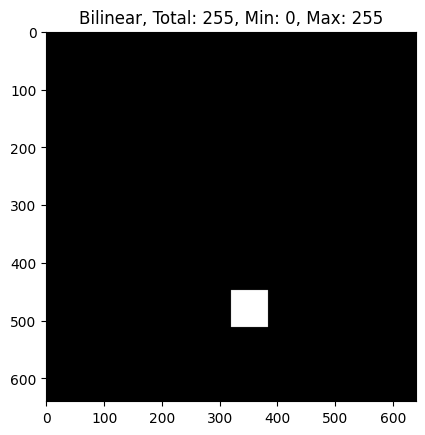

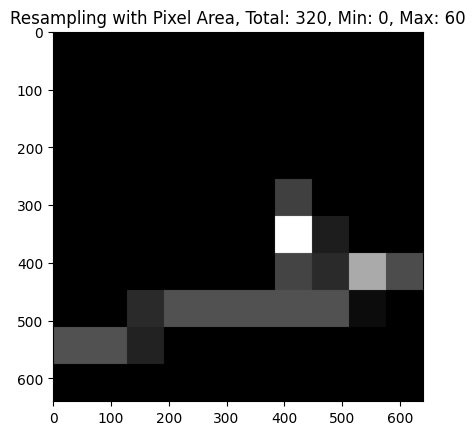

In [22]:

for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)

    plt.imshow(merge_resized, cmap='gray')
    plt.title(f'{name}, Total: {tot}, Min: {merge_resized.min()}, Max: {merge_resized.max()}')
    plt.show()

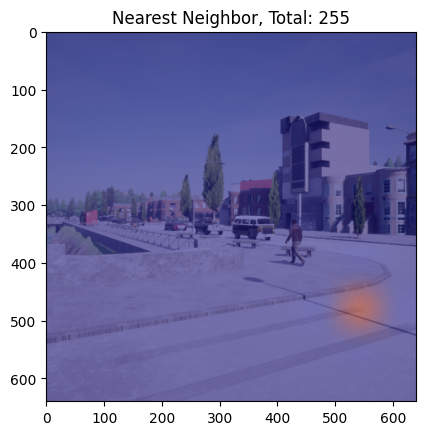

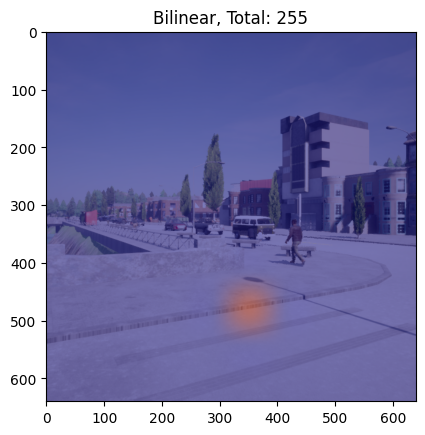

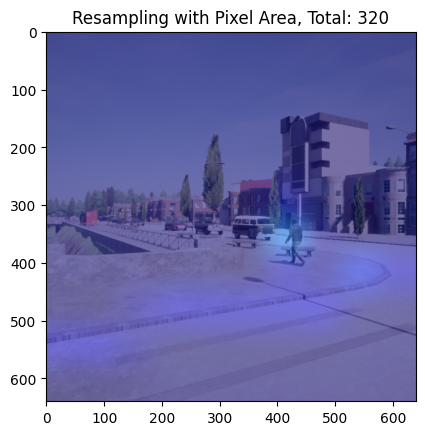

In [23]:
# Let's add the merge_resized to the original image as a heatmap and plot them
for name, interp in interpolations_dict.items():
    # Resize the merge image to 10x10, then upsale it to 640x640
    merge_resized = cv2.resize(merge, (10,10), interpolation=interp)
    tot = merge_resized.sum()
    # merge_resized = cv2.resize(merge_resized, (640,640), interpolation=cv2.INTER_NEAREST)
    merge_resized = np.delete(plt.get_cmap('jet')(merge_resized), 3, 2)
    merge_resized = Image.fromarray((255 * merge_resized).astype(np.uint8)).resize(src_img.shape[:2])
    # Add the heatmap to the original image as a mask
    src_img_copy = Image.fromarray(src_img.copy())

    # Blend them
    blend = Image.blend(src_img_copy, merge_resized, 0.5)

    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.show()

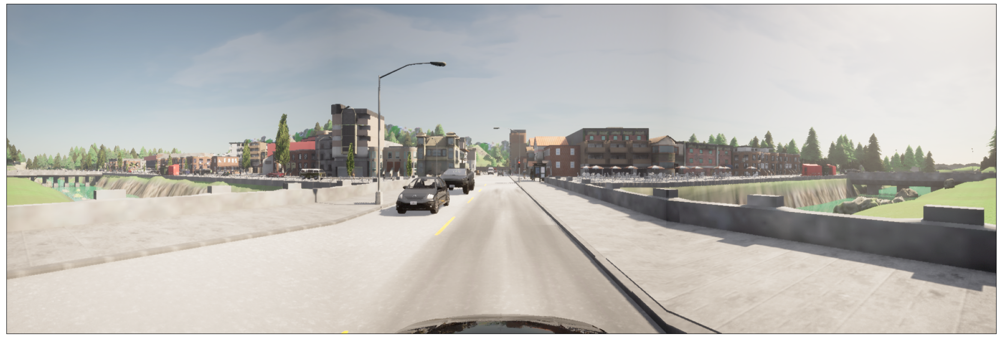

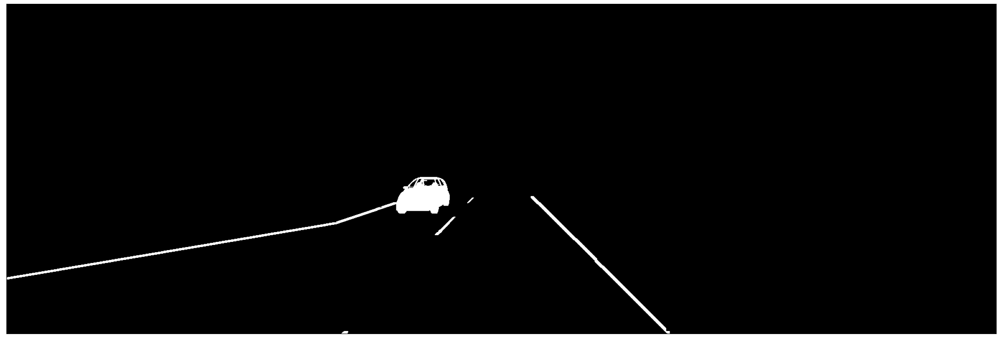

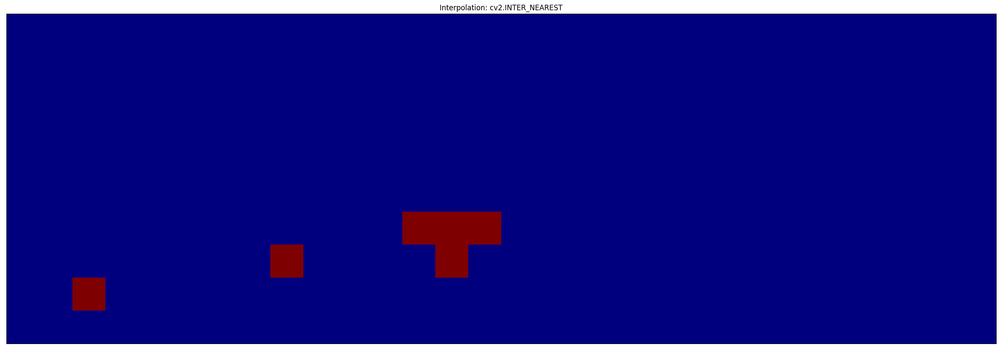

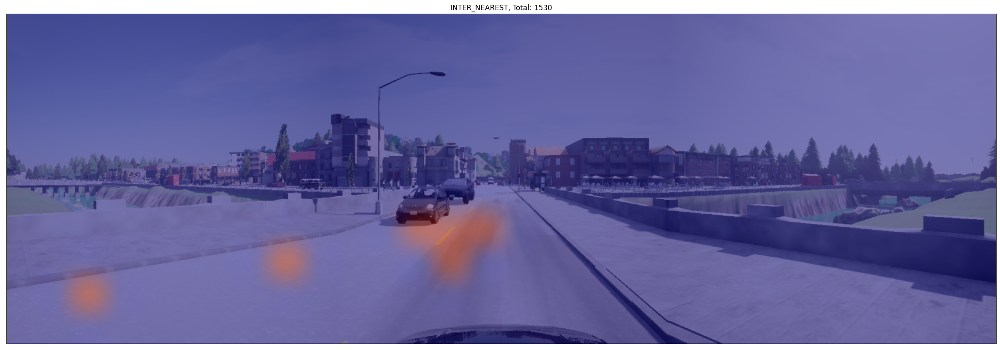

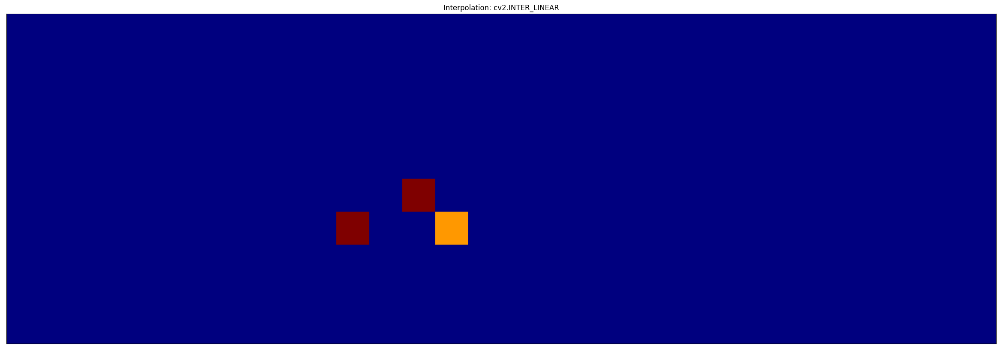

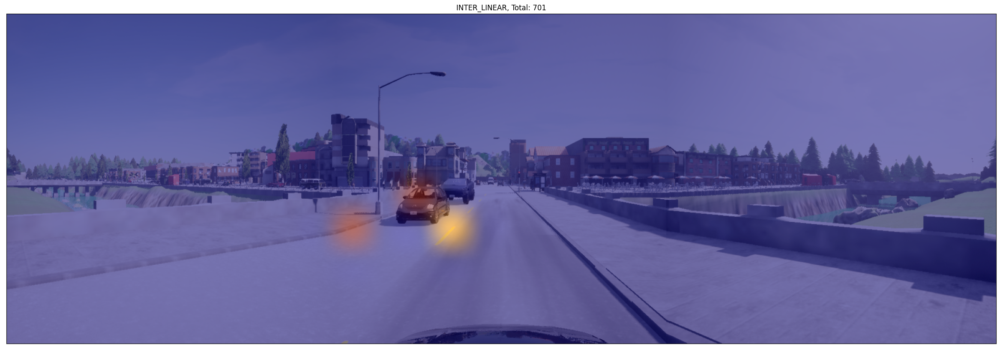

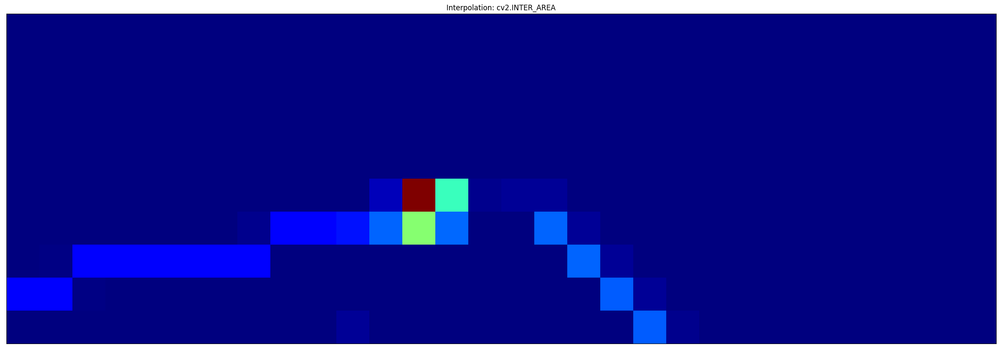

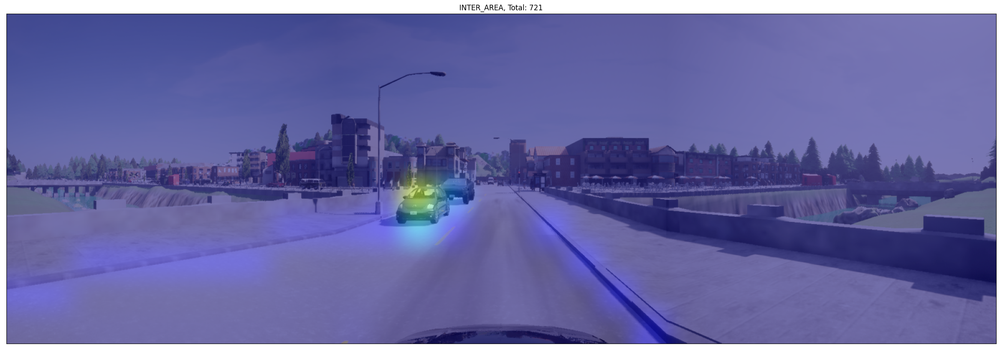

In [57]:
idx = 1
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx], central_camera=True)
src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data], central_camera=False)
src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data], central_camera=False)

# Concatenate the src_images and merge images horizontally
src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

# Plot them
plt.figure(figsize=(30, 10))
plt.imshow(src_img_concat)
plt.xticks([])
plt.yticks([])
plt.show()
plt.figure(figsize=(30, 10))
plt.imshow(merge_concat, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

# Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
interpolations_dict = {
    'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}
 
for name, interp in interpolations_dict.items():
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized = Image.fromarray((255 * merge_concat_resized).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    src_img_concat_copy = Image.fromarray(src_img_concat.copy())

    # Blend them
    blend = Image.blend(src_img_concat_copy, merge_concat_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.figure(figsize=(30, 10))
    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()


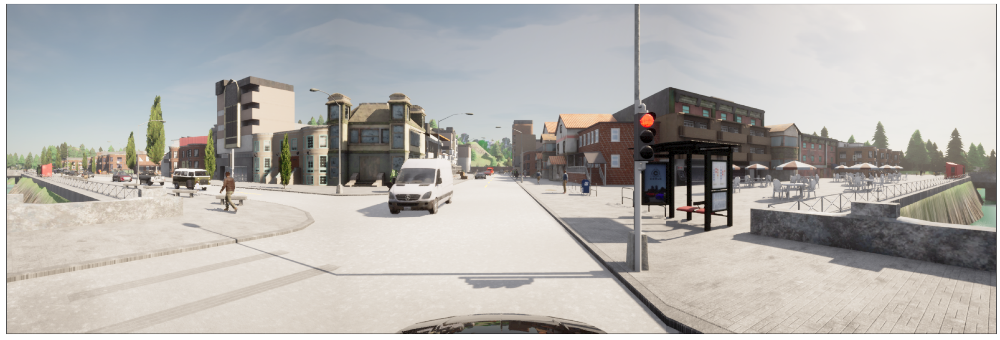

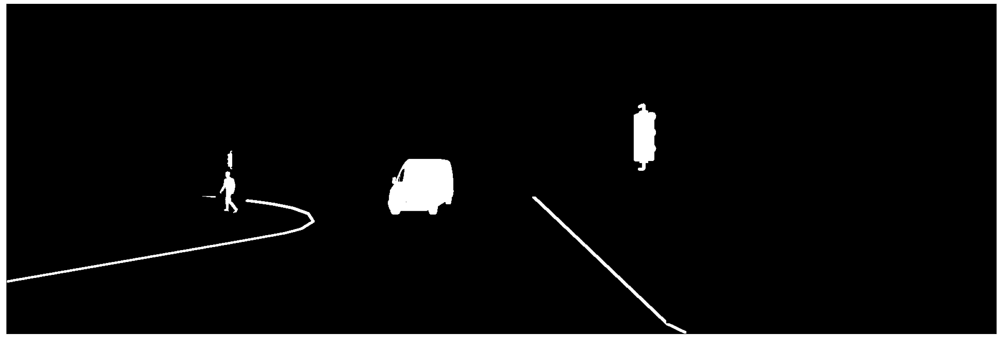

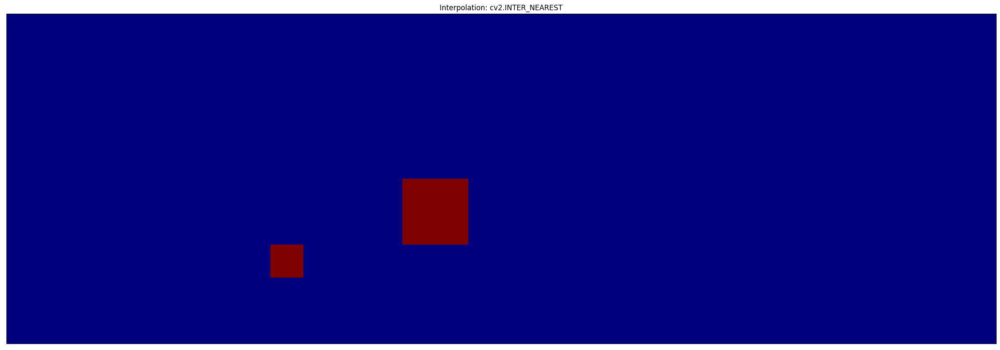

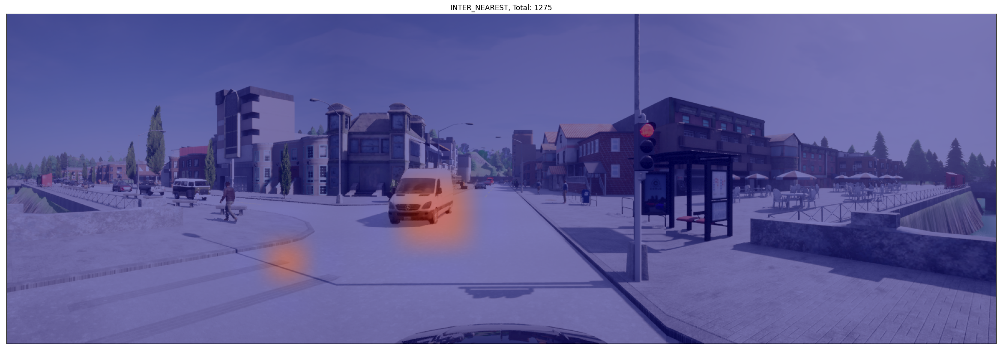

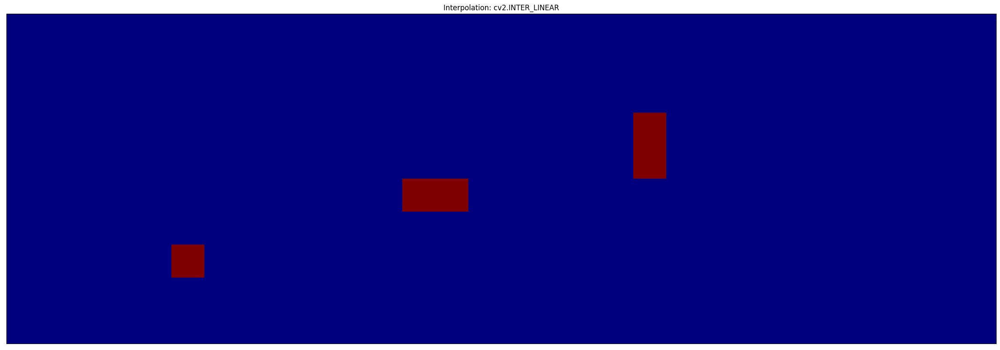

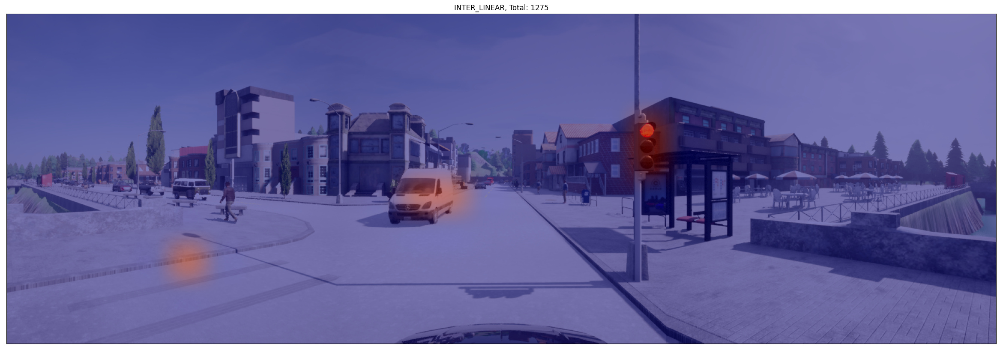

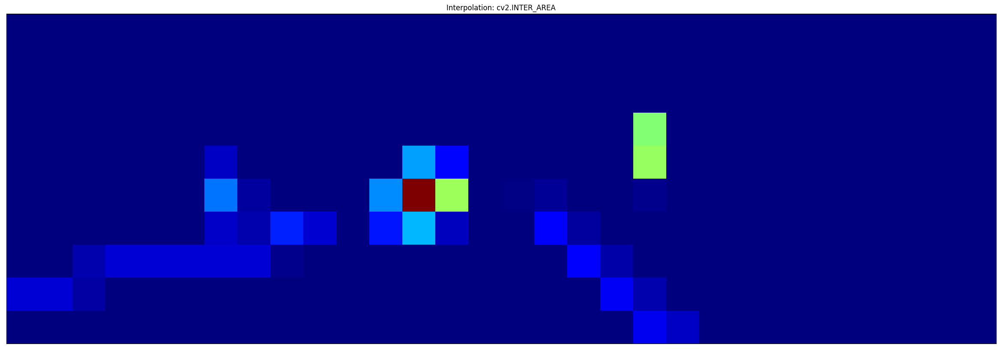

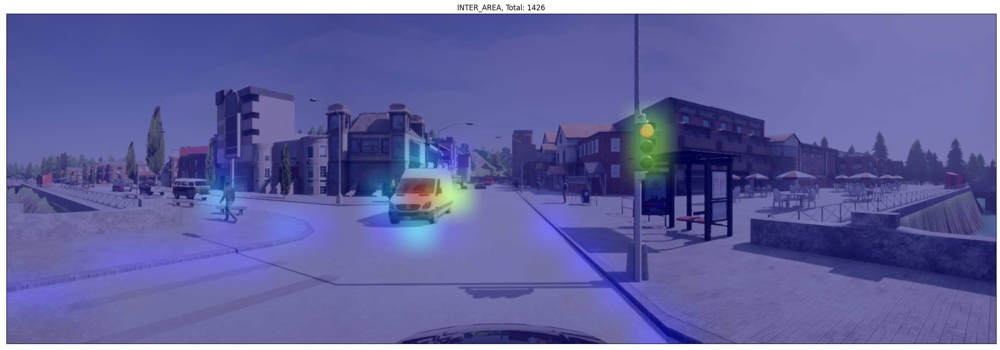

In [58]:
idx = 100
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx])
src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data])
src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data])

# Concatenate the src_images and merge images horizontally
src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

# Plot them
plt.figure(figsize=(30, 10))
plt.imshow(src_img_concat)
plt.xticks([])
plt.yticks([])
plt.show()
plt.figure(figsize=(30, 10))
plt.imshow(merge_concat, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

# Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
interpolations_dict = {
    'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}
 
for name, interp in interpolations_dict.items():
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized = Image.fromarray((255 * merge_concat_resized).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    src_img_concat_copy = Image.fromarray(src_img_concat.copy())

    # Blend them
    blend = Image.blend(src_img_concat_copy, merge_concat_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.figure(figsize=(30, 10))
    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()


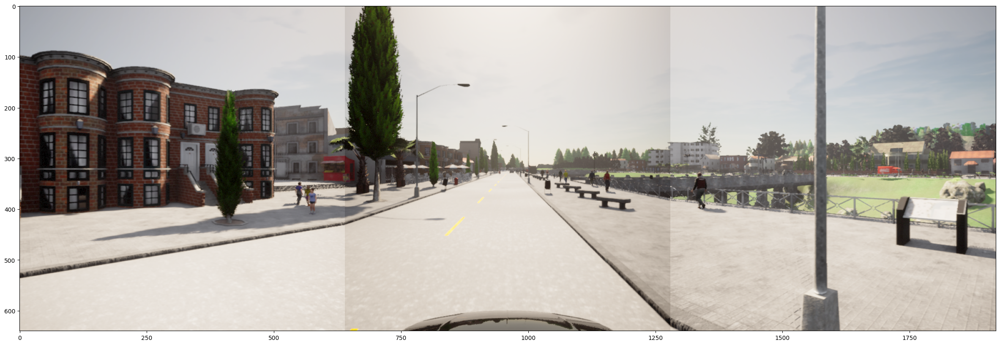

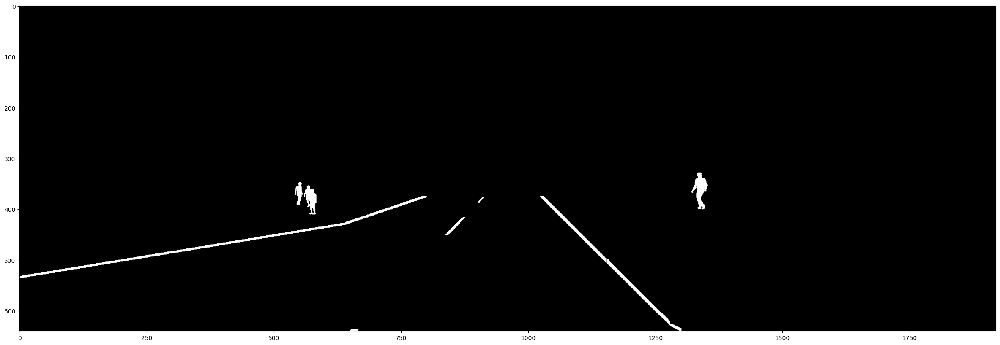

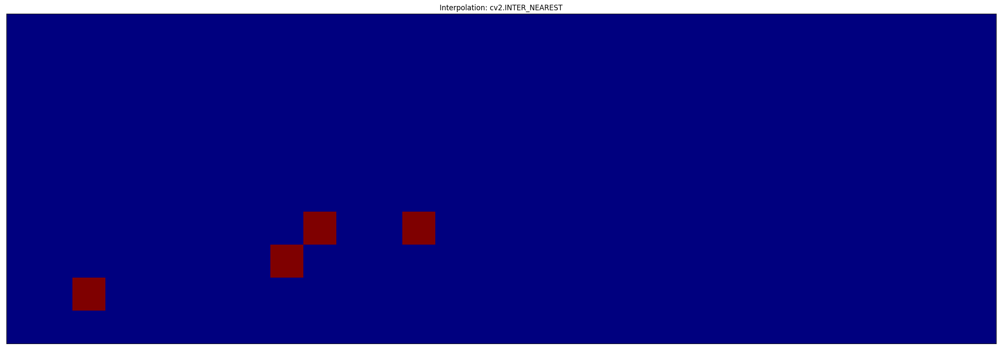

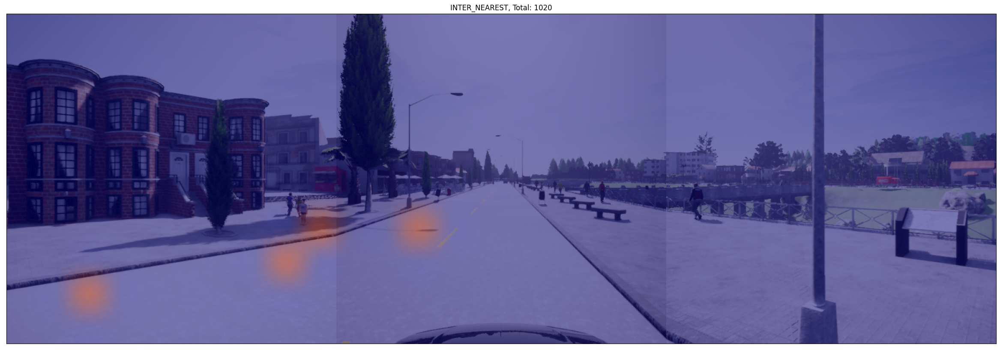

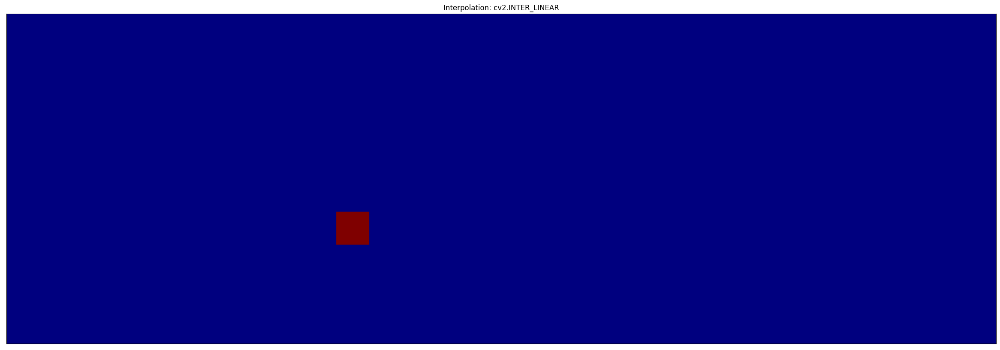

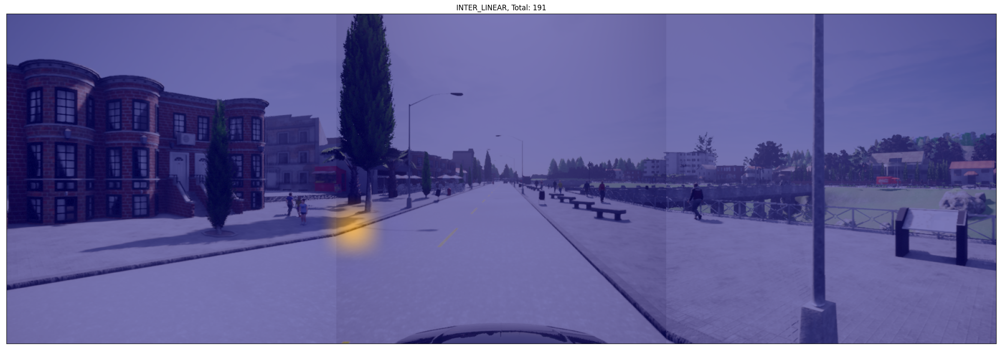

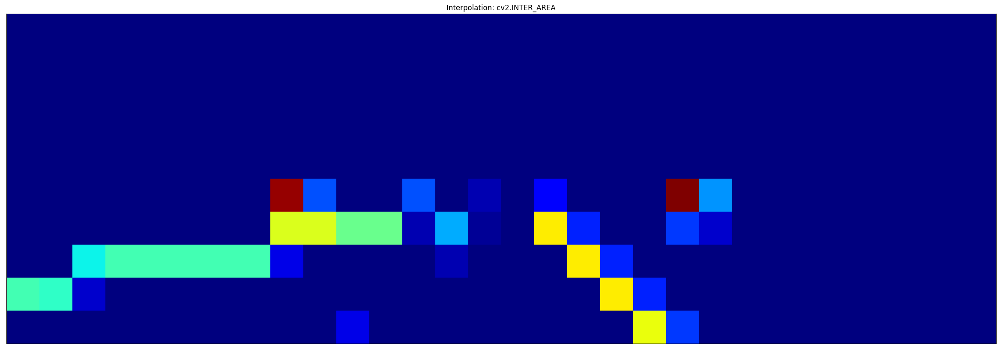

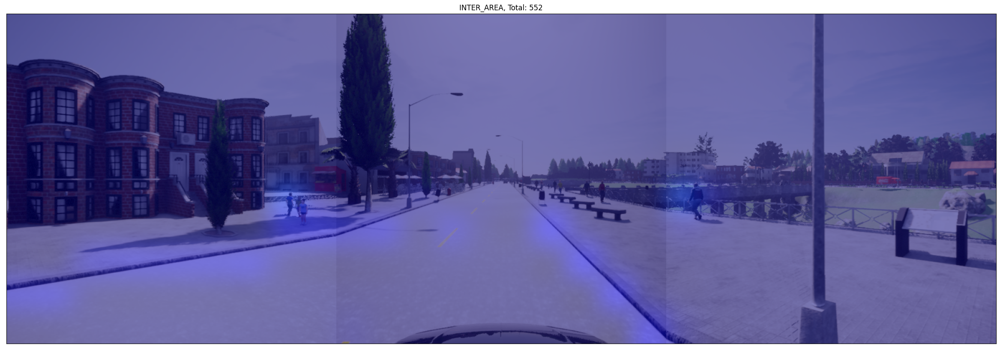

In [60]:
idx = num_data-1
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx])
src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data])
src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data])

# Concatenate the src_images and merge images horizontally
src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

# Plot them
plt.figure(figsize=(30, 10))
plt.imshow(src_img_concat)
plt.show()
plt.figure(figsize=(30, 10))
plt.imshow(merge_concat, cmap='gray')
plt.show()

# Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
interpolations_dict = {
    'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}
 
for name, interp in interpolations_dict.items():
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized = Image.fromarray((255 * merge_concat_resized).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    src_img_concat_copy = Image.fromarray(src_img_concat.copy())

    # Blend them
    blend = Image.blend(src_img_concat_copy, merge_concat_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.figure(figsize=(30, 10))
    plt.imshow(blend)
    plt.title(f'{name}, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()


## Let's turn any attention > 0 into a 1

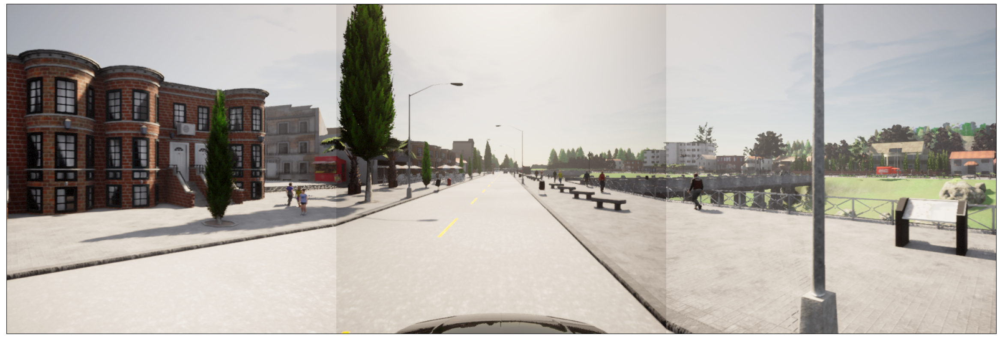

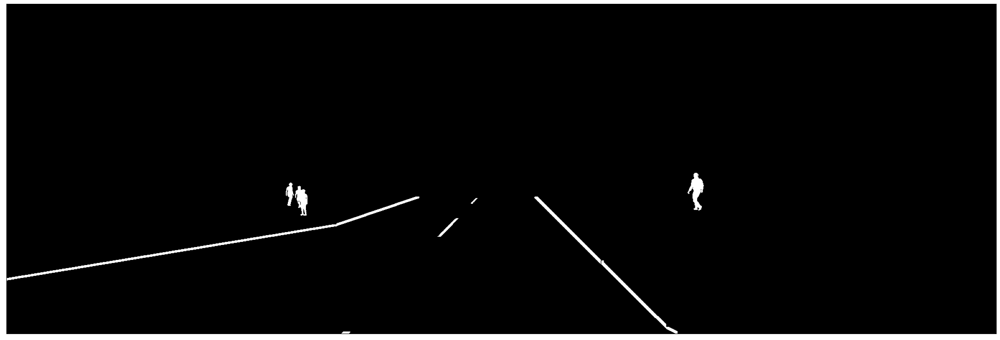

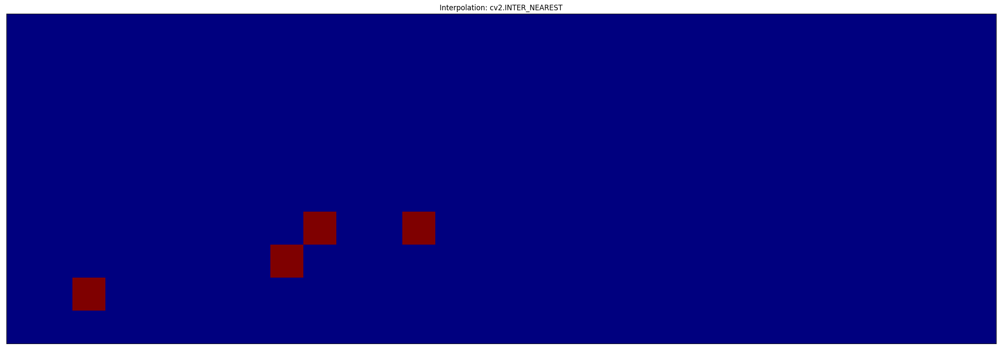

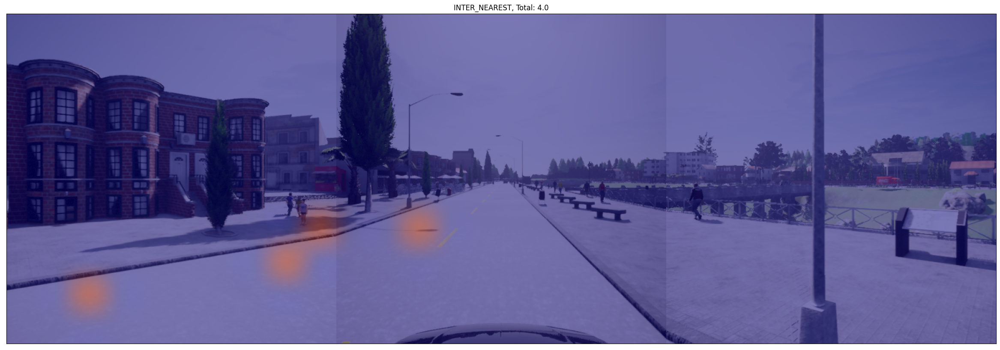

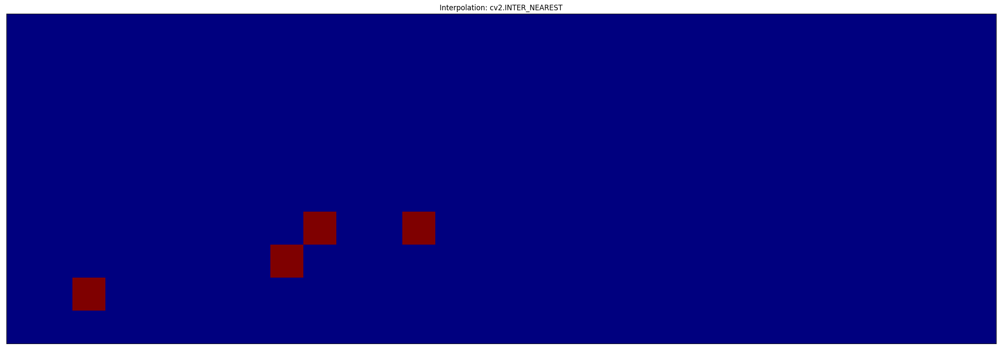

...

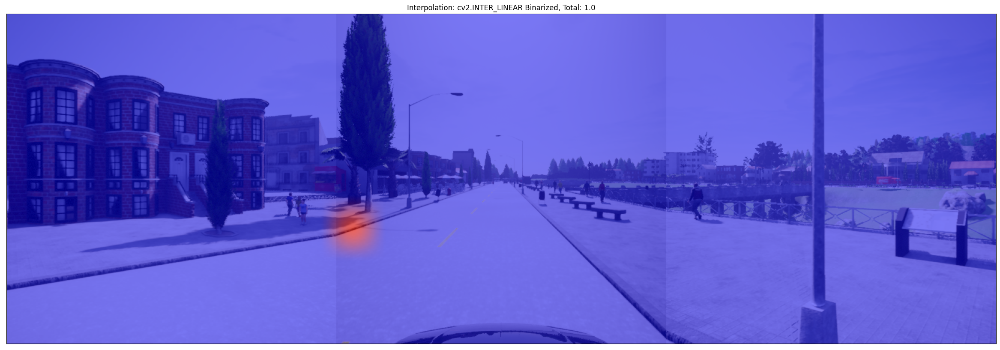

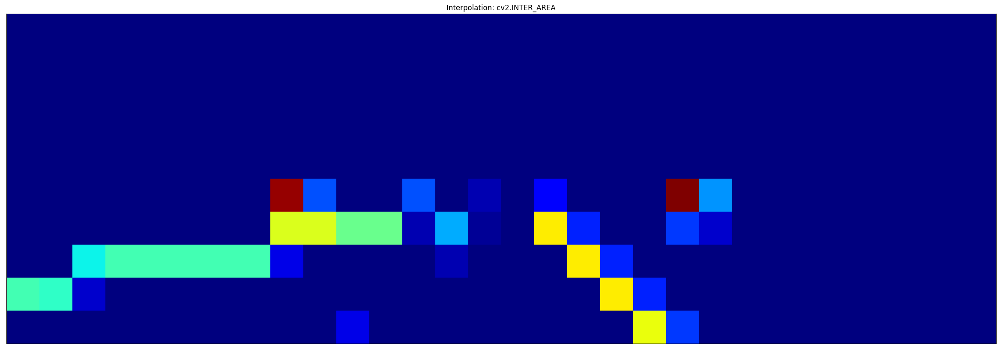

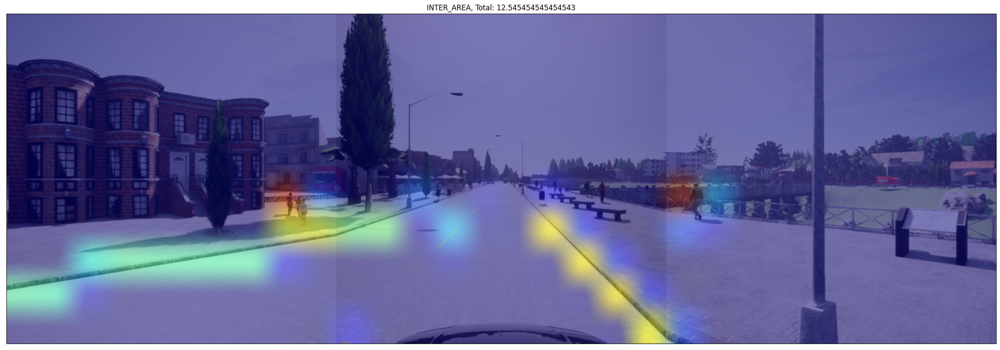

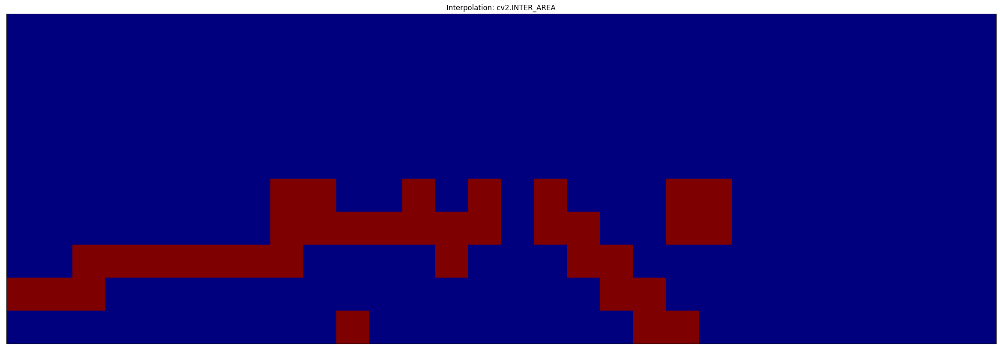

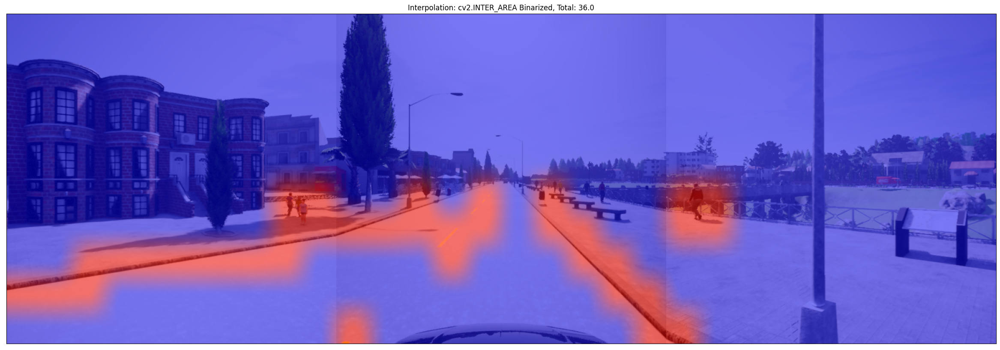

In [61]:
idx = num_data-1
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx])
src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data])
src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data])

# Concatenate the src_images and merge images horizontally
src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

# Plot them
plt.figure(figsize=(30, 10))
plt.imshow(src_img_concat)
plt.xticks([])
plt.yticks([])
plt.show()
plt.figure(figsize=(30, 10))
plt.imshow(merge_concat, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

# Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
interpolations_dict = {
    'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}

src_img_concat_copy = Image.fromarray(src_img_concat.copy())

for name, interp in interpolations_dict.items():
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
    merge_concat_resized = merge_concat_resized/merge_concat_resized.max()
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized_uprez = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized_uprez = Image.fromarray((255 * merge_concat_resized_uprez).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    
    blend = Image.blend(src_img_concat_copy, merge_concat_resized_uprez, 0.5)

    plt.figure(figsize=(30, 10))
    plt.imshow(blend)
    plt.title(f'{name}, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    # Now, set all the values > 0.0 in the merge_concat_resized to 1.0
    merge_concat_resized_binary = np.where(merge_concat_resized > 0.0, 1.0, 0.0)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized_binary, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    merge_concat_resized_binary_uprez = np.delete(plt.get_cmap('jet')(merge_concat_resized_binary), 3, 2)
    merge_concat_resized_binary_uprez = merge_concat_resized_binary_uprez / merge_concat_resized_binary_uprez.max()
    merge_concat_resized_binary_uprez = Image.fromarray((255 * merge_concat_resized_binary_uprez).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    new_tot = merge_concat_resized_binary.sum()
    # Add the heatmap to the original image as a mask
    blend = Image.blend(src_img_concat_copy, merge_concat_resized_binary_uprez, 0.5)

    plt.figure(figsize=(30, 10))
    plt.imshow(blend)
    plt.title(f'Interpolation: cv2.{name} Binarized, Total: {new_tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

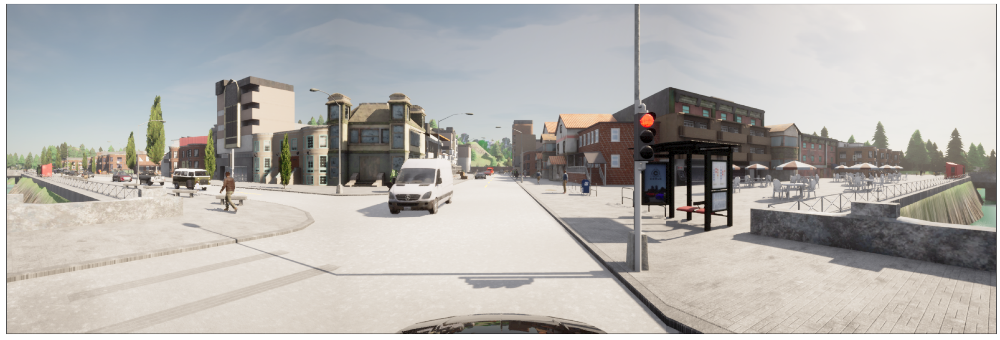

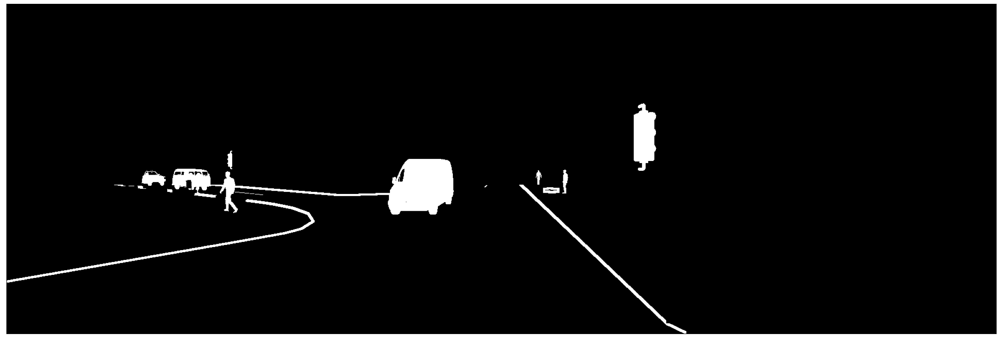

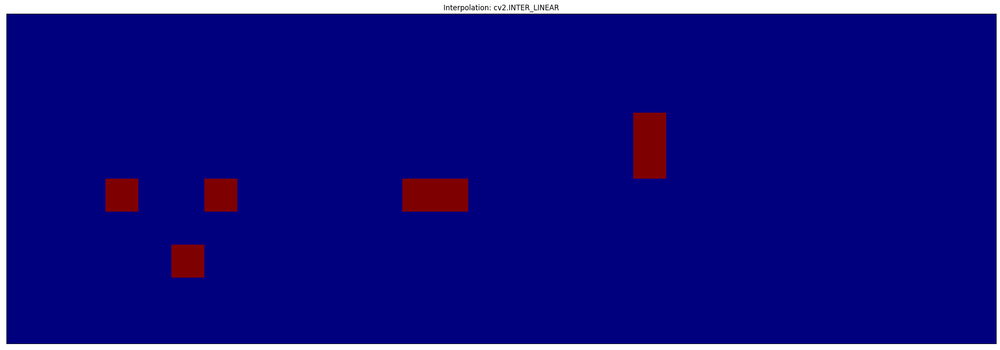

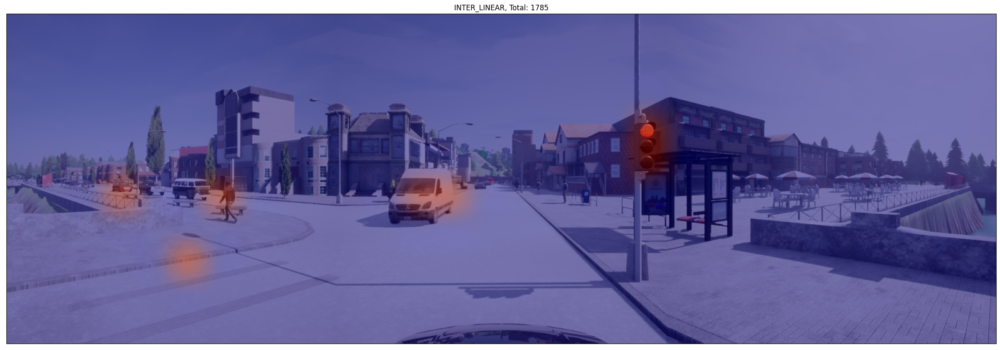

In [68]:
DEPTH_THRESHOLD = 35

idx = 100
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx])
src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data])
src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data])

# Concatenate the src_images and merge images horizontally
src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

# Plot them
plt.figure(figsize=(30, 10))
plt.imshow(src_img_concat)
plt.xticks([])
plt.yticks([])
plt.show()
plt.figure(figsize=(30, 10))
plt.imshow(merge_concat, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

# Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
interpolations_dict = {
    # 'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    # 'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}
 
for name, interp in interpolations_dict.items():
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='jet')
    plt.title(f'Interpolation: cv2.{name}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized = Image.fromarray((255 * merge_concat_resized).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    src_img_concat_copy = Image.fromarray(src_img_concat.copy())

    # Blend them
    blend = Image.blend(src_img_concat_copy, merge_concat_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.figure(figsize=(30, 10))
    plt.imshow(blend, cmap='jet')
    plt.title(f'{name}, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

In [30]:
save_path = os.path.join(os.getcwd(), 'videos')
if not os.path.exists(save_path):
    os.makedirs(save_path)

interpolations_dict = {
    'INTER_NEAREST': cv2.INTER_NEAREST, 
    'INTER_LINEAR': cv2.INTER_LINEAR, 
    # 'Bicubic': cv2.INTER_CUBIC, 
    'INTER_AREA': cv2.INTER_AREA, 
    # 'Lanczos4': cv2.INTER_LANCZOS4,
    # 'Bit exact Biinear': cv2.INTER_LINEAR_EXACT
}


for name, interp in interpolations_dict.items():
    for idx in tqdm(range(num_data), desc=f'Creating videos for {name} interpolation', total=num_data):
        # Get the images, ss, mask, etc. for the three cameras
        src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx], depth_paths[idx], ss_paths[idx])
        src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx + num_data], depth_paths[idx + num_data], ss_paths[idx + num_data])
        src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], depth_paths[idx + 2*num_data], ss_paths[idx + 2*num_data])

        # Concatenate the src_images and merge images horizontally
        src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
        src_img_concat_copy = Image.fromarray(src_img_concat.copy())
        merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

        # Now, downscale the merge_concat
        merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=interp)
        merge_concat_resized = merge_concat_resized/merge_concat_resized.max()


        merge_concat_resized_uprez = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
        merge_concat_resized_uprez = Image.fromarray((255 * merge_concat_resized_uprez).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
        blend = Image.blend(src_img_concat_copy, merge_concat_resized_uprez, 0.5)

        # Now, set all the values > 0.0 in the merge_concat_resized to 1.0
        merge_concat_resized_binary = np.where(merge_concat_resized > 0.0, 1.0, 0.0)

        merge_concat_resized_binary_uprez = np.delete(plt.get_cmap('jet')(merge_concat_resized_binary), 3, 2)
        merge_concat_resized_binary_uprez = merge_concat_resized_binary_uprez / merge_concat_resized_binary_uprez.max()
        merge_concat_resized_binary_uprez = Image.fromarray((255 * merge_concat_resized_binary_uprez).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
        new_tot = merge_concat_resized_binary.sum()
        # Add the heatmap to the original image as a mask
        blend_binary = Image.blend(src_img_concat_copy, merge_concat_resized_binary_uprez, 0.5)

        # Save to a mp4 video
        if idx == 0:
            fourcc = cv2.VideoWriter_fourcc(*'mp4v')
            out_pre = cv2.VideoWriter(os.path.join(save_path, f'merge_{name}.mp4'), fourcc, 20.0, (blend.size[0], blend.size[1]))
            out_post = cv2.VideoWriter(os.path.join(save_path, f'merge_binary_{name}.mp4'), fourcc, 20.0, (blend.size[0], blend.size[1]))

        out_pre.write(cv2.cvtColor(np.array(blend), cv2.COLOR_RGB2BGR))
        out_post.write(cv2.cvtColor(np.array(blend_binary), cv2.COLOR_RGB2BGR))

        # if idx == 50:
        #     break

    out_pre.release()
    out_post.release()

Creating videos for INTER_NEAREST interpolation:   0%|          | 0/2248 [00:00<?, ?it/s]

Creating videos for INTER_AREA interpolation: 100%|██████████| 2248/2248 [36:31<00:00,  1.03it/s]
